**Install Detectron 2 from github**

In [1]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Requirement already up-to-date: torch in /usr/local/lib/python3.7/dist-packages (1.9.0+cu102)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.7/dist-packages (0.10.0+cu102)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-748t8vzo
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-748t8vzo
     |████████████████████████████████| 645kB 7.7MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5-cp37-none-any.whl size=64497 sha256=0dc44c0d6cb010ff1f8da9651567e37c0c60b6f76823653de34476f31b08a0b6
  Stored in directory: /tmp/pip-ephem-wheel-cache-mq1jaika/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
Successfully built fvcore
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Cloning into 'detectron2_repo'...
remote: Enumerating objects: 12533, done.
remote: Counting objects: 100% (27/27), done.
remote: Compres

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Register custom dataset**

In [2]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("data_train", {}, "/content/drive/MyDrive/TraningML/FRCNN/train/train_coco_format.json", "/content/drive/MyDrive/TraningML/FRCNN/train/images")
register_coco_instances("data_val", {}, "/content/drive/MyDrive/TraningML/FRCNN/val/val_coco_format.json", "/content/drive/MyDrive/TraningML/FRCNN/val/images")
register_coco_instances("data_test", {}, "/content/drive/MyDrive/TraningML/FRCNN/test/coco_format.json", "/content/drive/MyDrive/TraningML/FRCNN/test/images")


In [4]:
from detectron2.data import MetadataCatalog
from detectron2.data import DatasetCatalog

train_metadata =MetadataCatalog.get("data_train")
dataset_dicts = DatasetCatalog.get("data_train")

val_metadata = MetadataCatalog.get("data_val")
dataset_dicts = DatasetCatalog.get("data_val")


test_metadata = MetadataCatalog.get("data_test")
dataset_dicts = DatasetCatalog.get("data_test")


[07/10 02:12:00 d2.data.datasets.coco]: Loading /content/drive/MyDrive/TraningML/FRCNN/train/train_coco_format.json takes 1.02 seconds.
WARNING [07/10 02:12:00 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/10 02:12:00 d2.data.datasets.coco]: Loaded 4311 images in COCO format from /content/drive/MyDrive/TraningML/FRCNN/train/train_coco_format.json
WARNING [07/10 02:12:01 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/10 02:12:01 d2.data.datasets.coco]: Loaded 1437 images in COCO format from /content/drive/MyDrive/TraningML/FRCNN/val/val_coco_format.json
WARNING [07/10 02:12:02 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/10 02:12:02 d2.data.datasets.coco]: Loaded 1437 images in COCO format from /content/drive/MyDrive/TraningML/FRCNN/test/coco_format.json


**Visualizer random image**

WARNING [07/10 02:17:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/10 02:17:16 d2.data.datasets.coco]: Loaded 4311 images in COCO format from /content/drive/MyDrive/TraningML/FRCNN/train/train_coco_format.json


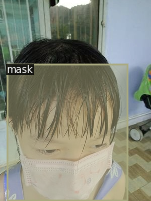

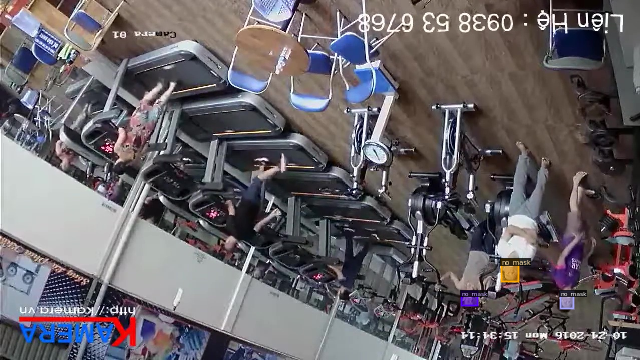

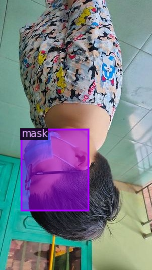

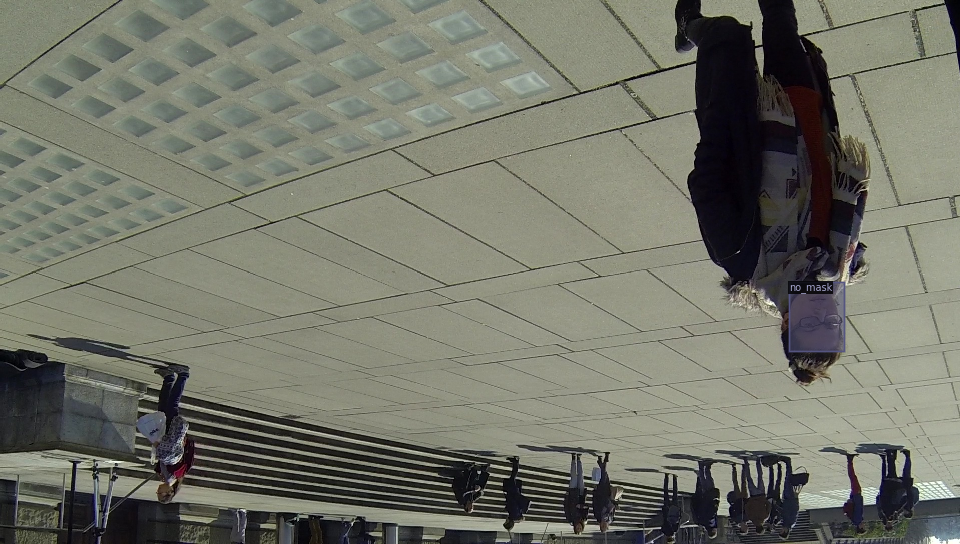

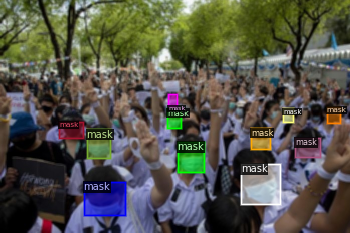

...

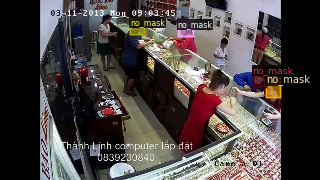

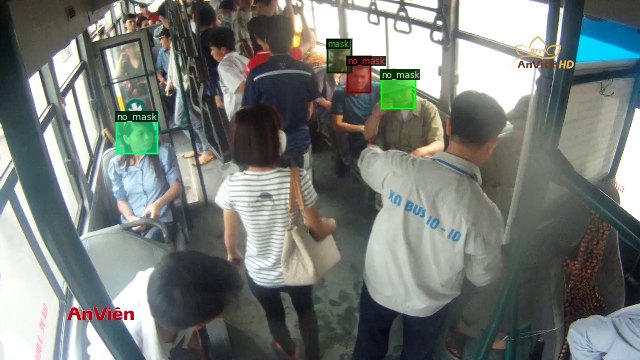

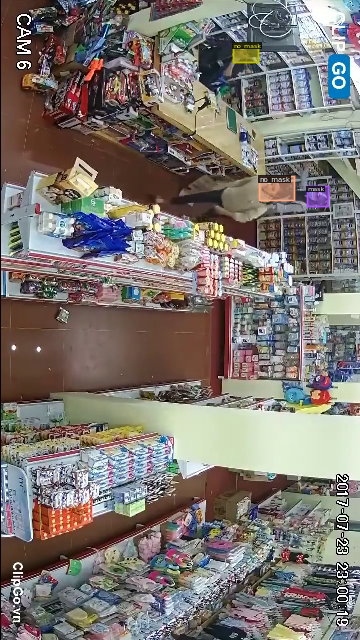

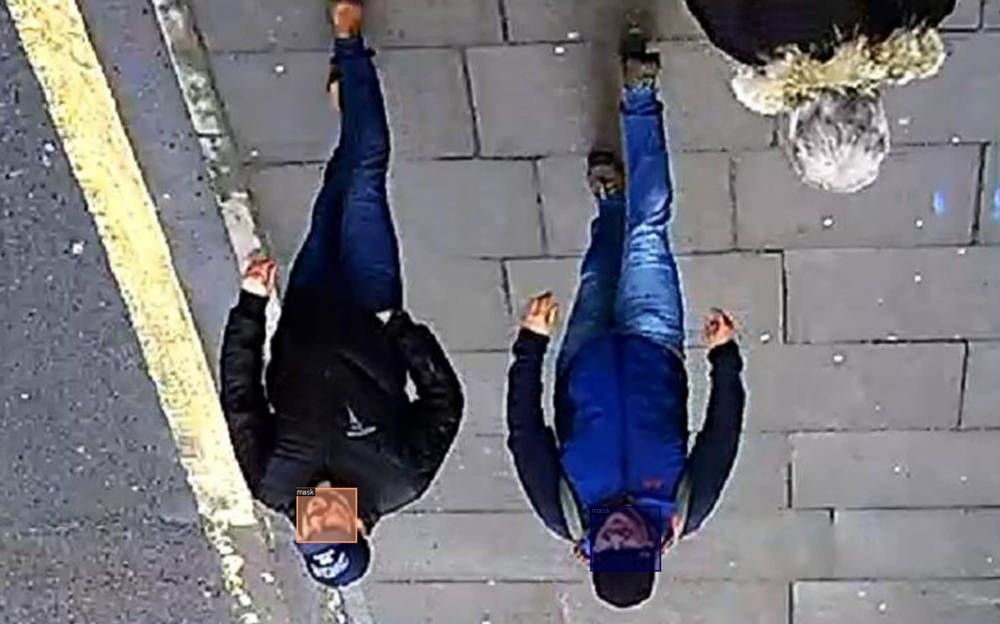

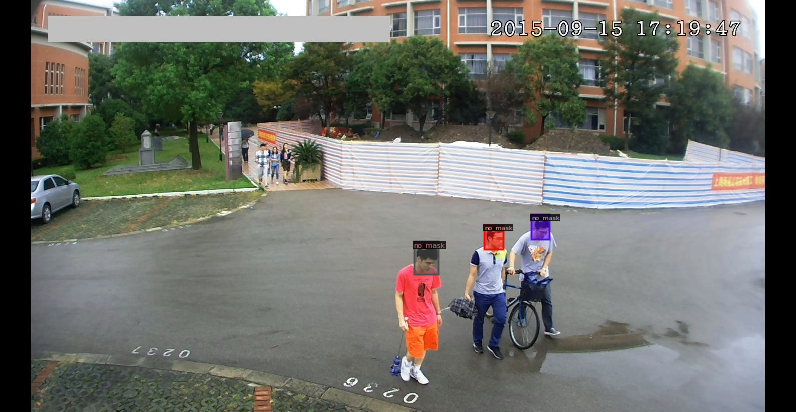

In [6]:
import random
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow

train_metadata =MetadataCatalog.get("data_train")
dataset_dicts = DatasetCatalog.get("data_train")

for d in random.sample(dataset_dicts, 30):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

**Train model**

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
from detectron2 import model_zoo
cfg = get_cfg()
cfg.merge_from_file(
    model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")
)
cfg.DATASETS.TRAIN = ("data_train",)
cfg.DATASETS.TEST = ("data_test",)  # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.MAX_ITER = (
    1000
)  # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (
    4
)  # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 17  # 2 classes (data, fig, hazelnut)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[07/08 08:26:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:06, 69.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (18, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (18,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (68, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (68,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box

[07/08 08:26:56 d2.engine.train_loop]: Starting training from iteration 0
[07/08 08:28:06 d2.utils.events]:  eta: 0:57:41  iter: 19  total_loss: 3.897  loss_cls: 3.049  loss_box_reg: 0.6124  loss_rpn_cls: 0.2017  loss_rpn_loc: 0.02671  time: 3.5072  data_time: 0.0578  lr: 1.9981e-05  max_mem: 11898M
[07/08 08:29:18 d2.utils.events]:  eta: 0:56:31  iter: 39  total_loss: 3.468  loss_cls: 2.734  loss_box_reg: 0.4929  loss_rpn_cls: 0.164  loss_rpn_loc: 0.02714  time: 3.5548  data_time: 0.0677  lr: 3.9961e-05  max_mem: 11898M
[07/08 08:30:29 d2.utils.events]:  eta: 0:55:38  iter: 59  total_loss: 2.861  loss_cls: 2.151  loss_box_reg: 0.4529  loss_rpn_cls: 0.1494  loss_rpn_loc: 0.03407  time: 3.5529  data_time: 0.0649  lr: 5.9941e-05  max_mem: 11898M
[07/08 08:31:40 d2.utils.events]:  eta: 0:54:38  iter: 79  total_loss: 2.219  loss_cls: 1.397  loss_box_reg: 0.6417  loss_rpn_cls: 0.1181  loss_rpn_loc: 0.03049  time: 3.5534  data_time: 0.0401  lr: 7.9921e-05  max_mem: 11898M
[07/08 08:32:51 d2.

**Save model**

In [ ]:
# import shutil
import os
!cp {os.path.join(cfg.OUTPUT_DIR, "model_final.pth")} '/content/drive/MyDrive/TraningML/FRCNN'

**Evaluation**

In [ ]:

# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

**Test model with image**

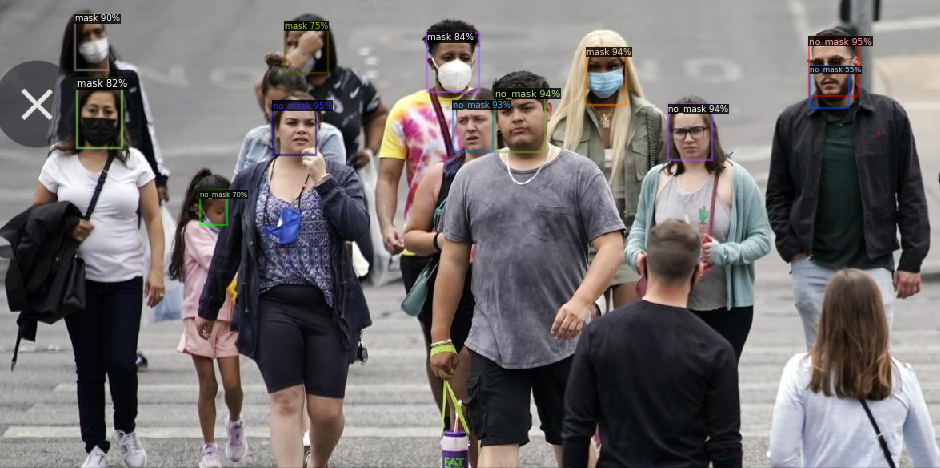

In [10]:
from detectron2.utils.visualizer import ColorMode
from google.colab.patches import cv2_imshow
import random
import cv2
from detectron2.utils.visualizer import Visualizer
from detectron2.engine import DefaultPredictor


# for d in random.sample(dataset_dicts, 3):    
#     im = cv2.imread(d["file_name"])
#     outputs = predictor(im)
#     v = Visualizer(im[:, :, ::-1],
#                    metadata=fruits_nuts_metadata, 
#                    scale=0.8, 
#                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
#     )
#     v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
#     cv2_imshow(v.get_image()[:, :, ::-1])
cfg.MODEL.WEIGHTS = '/content/drive/MyDrive/TraningML/FRCNN/model_final.pth'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
im = cv2.imread("/content/drive/MyDrive/TraningML/FRCNN/test/images/53_6_img_son_337.jpg")
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                metadata=train_metadata, 
                scale=0.8, 
                instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

**Test model with video**

In [5]:
#!/usr/bin/env python3
# -- coding: utf-8 --

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import tqdm
import cv2
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.data import MetadataCatalog
import time
from detectron2.engine import DefaultPredictor

# Extract video properties
video = cv2.VideoCapture('/content/drive/MyDrive/TraningML/datasets/video/video_16.mp4')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Initialize video writer
video_writer = cv2.VideoWriter('out1.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)

# Initialize predictor
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 17
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/TraningML/FRCNN/model_final.pth"
predictor = DefaultPredictor(cfg)

# Initialize visualizer
v = VideoVisualizer(train_metadata, ColorMode.IMAGE)

def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            break

        # Get prediction results for this frame
        outputs = predictor(frame)

        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        # Draw a visualization of the predictions using the video visualizer
        visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

        # Convert Matplotlib RGB format to OpenCV BGR format
        visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

        yield visualization

        readFrames += 1
        if readFrames > maxFrames:
            break

# Create a cut-off for debugging
num_frames = 4000

# Enumerate the frames of the video
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

    # Write test image
    cv2.imwrite('POSE detectron2.png', visualization)

    # Write to video file
    video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()

  0%|          | 0/4000 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
  6%|▋     